In [1]:
from graphviz import Graph, Digraph
from PIL import Image
from IPython.display import display, Image
import pandas as pd
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx

# import the data and turn first column into index, making sure numbers are not read as strings

In [2]:
# read data
df = pd.read_csv('Input_data/' + 'single_type_chart' + '.csv', index_col=0)
# print("Original DataFrame dtypes:")
# print(df.dtypes)

# Convert all columns to numeric, coercing errors to NaN
# df = df.apply(pd.to_numeric)

# print("\nDataFrame after conversion:")
# print(df)
# print("\nNew DataFrame dtypes:")
# print(df.dtypes)
df.head()

,Normal,Fire,Water,Electric,Grass,Ice,Fighting,Poison,Ground,Flying,Psychic,Bug,Rock,Ghost,Dragon,Dark,Steel,Fairy
defense\attack,,,,,,,,,,,,,,,,,,
Normal,1.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0
Fire,1.0,0.5,2.0,1.0,0.5,0.5,1.0,1.0,2.0,1.0,1.0,0.5,2.0,1.0,1.0,1.0,0.5,0.5
Water,1.0,0.5,0.5,2.0,2.0,0.5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.5,1.0
Electric,1.0,1.0,1.0,0.5,1.0,1.0,1.0,1.0,2.0,0.5,1.0,1.0,1.0,1.0,1.0,1.0,0.5,1.0
Grass,1.0,2.0,0.5,0.5,0.5,2.0,1.0,2.0,0.5,2.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0


# calculate data for graph of nodes n edges

In [18]:
ptypes = df.columns.to_list()
ptypes
ntypes = len(ptypes)

# Graph the network

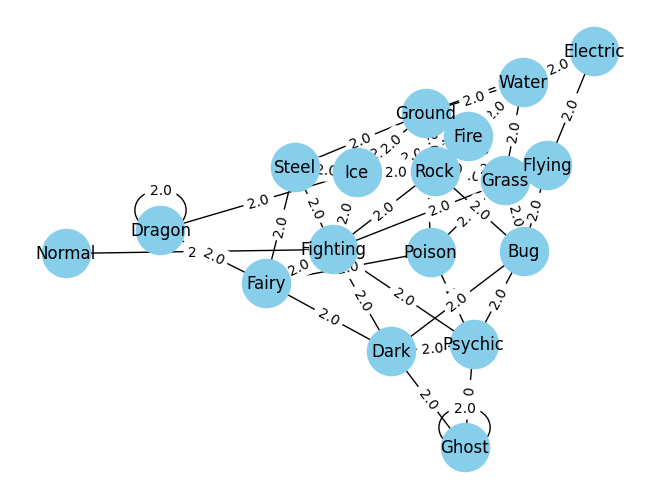

In [4]:
# Create a graph
G = nx.Graph()  # or nx.DiGraph() if it's directed
G.add_nodes_from(df.index)

# Add edges where entry > 1
for i in df.index:
    for j in df.columns:
        if df.loc[i, j] > 1:
            G.add_edge(i, j, weight=df.loc[i, j])

# Draw the graph
pos = nx.spring_layout(G)  # positions for layout
edge_labels = nx.get_edge_attributes(G, 'weight')

nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=1200, font_size=12)
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels)
plt.show()

# Heat Map

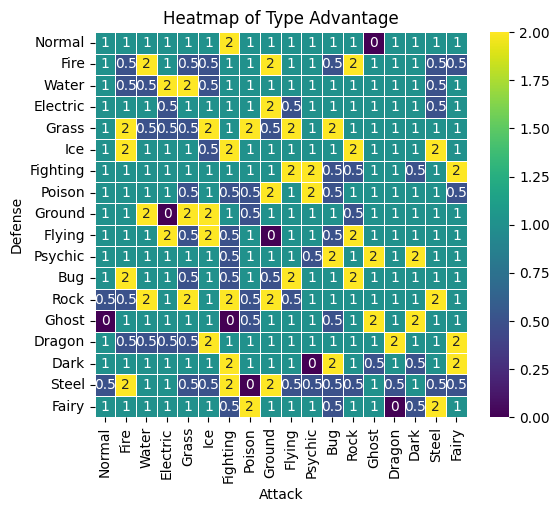

In [6]:
# Create the heatmap
plt.figure(figsize=(6, 5)) # Adjust figure size as needed
sns.heatmap(df, annot=True, cmap='viridis', linewidths=.5, cbar=True)

# Add labels and title
plt.title('Heatmap of Type Advantage')
plt.xlabel('Attack')
plt.ylabel('Defense')

# Display the plot
plt.show()

# full graph

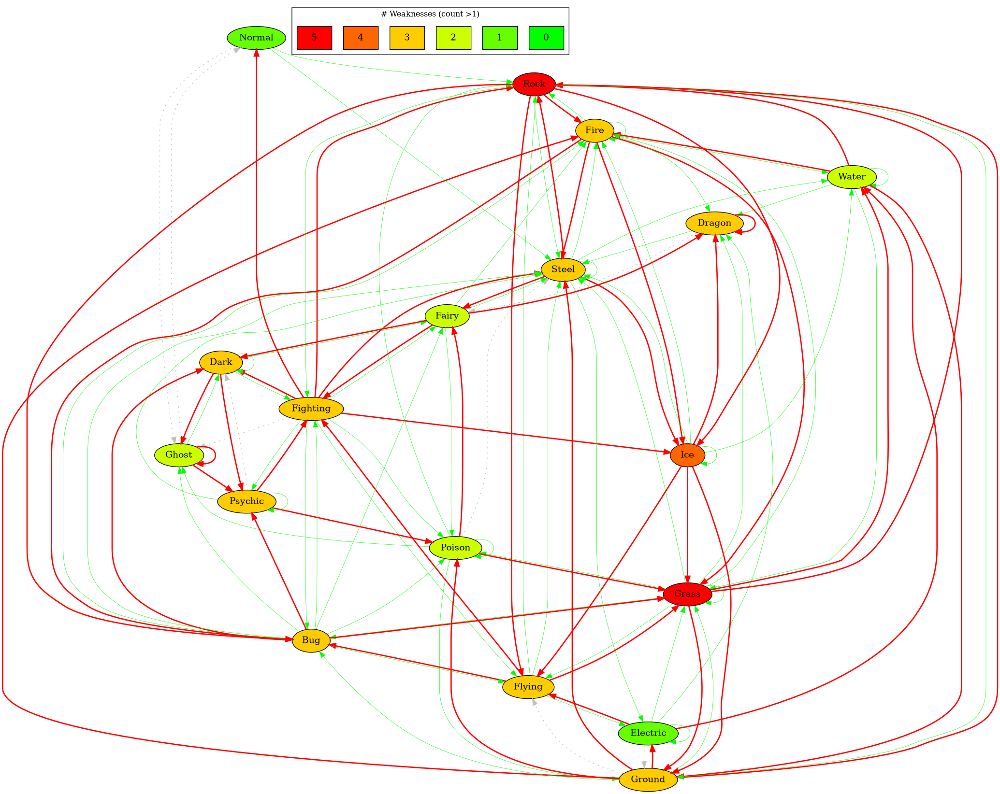

In [7]:
dot = Digraph(engine='dot')

# Count how many entries > 1 per row
counts = (df > 1).sum(axis=1)
max_count = counts.max()

# Interpolate green -> yellow -> red
def color_for_value(val, vmax):
    if vmax == 0:
        return "#cccccc"  # gray if everything is zero
    ratio = val / vmax
    if ratio <= 0.5:
        # Green to Yellow: increase red from 0 to 255, keep green = 255
        r = int(510 * ratio)
        g = 255
        b = 0
    else:
        # Yellow to Red: keep red = 255, decrease green from 255 to 0
        r = 255
        g = int(255 * (1 - 2*(ratio-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

# Build a color map for all integers 0..max_count
palette = {i: color_for_value(i, max_count) for i in range(max_count+1)}
node_colors = {node: palette[counts[node]] for node in counts.index}

# Add nodes with fill color
for n in df.index:
    dot.node(n, style='filled', fillcolor=node_colors[n])

# Add edges where entry > 1, thickness scaled by value (no labels)
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
            
        if weight == 2:
            c = 'red'
            dot.edge(j, i, penwidth=str(weight), color=c)

        if weight == 0.5:
            c = 'green'
            dot.edge(j, i, penwidth=str(weight), color=c)

        elif weight == 0:
            # show zero-weight edges as dotted
            dot.edge(j, i, style='dotted', penwidth='1', color='gray')


# Add a legend showing colors for each integer
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='# Weaknesses (count >1)', fontsize='12')
    for val, color in palette.items():
        legend.node(f"L{val}", str(val), style='filled', fillcolor=color, shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# number of receive strong x2 damage from something

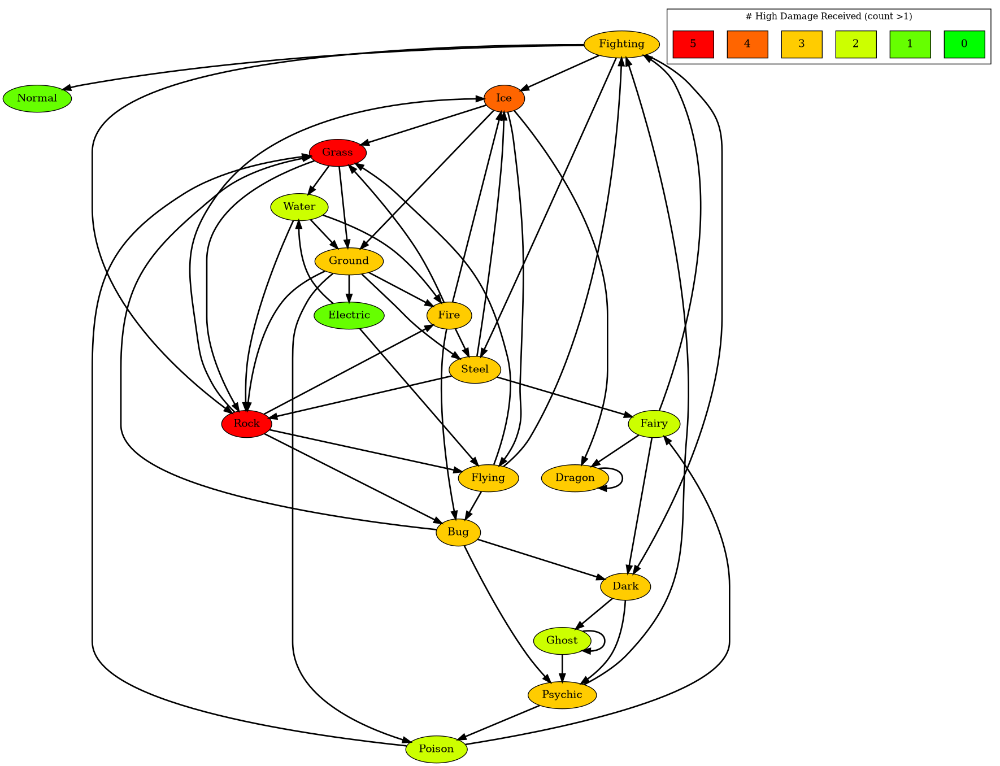

In [8]:
dot = Digraph(engine='dot')

# Count how many entries > 1 per row
counts = (df > 1).sum(axis=1)
max_count = counts.max()

# Interpolate green -> yellow -> red
def color_for_value(val, vmax):
    if vmax == 0:
        return "#cccccc"  # gray if everything is zero
    ratio = val / vmax
    if ratio <= 0.5:
        # Green to Yellow: increase red from 0 to 255, keep green = 255
        r = int(510 * ratio)
        g = 255
        b = 0
    else:
        # Yellow to Red: keep red = 255, decrease green from 255 to 0
        r = 255
        g = int(255 * (1 - 2*(ratio-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

# Build a color map for all integers 0..max_count
palette = {i: color_for_value(i, max_count) for i in range(max_count+1)}
node_colors = {node: palette[counts[node]] for node in counts.index}

# Add nodes with fill color
for n in df.index:
    dot.node(n, style='filled', fillcolor=node_colors[n])

# Add edges where entry > 1, thickness scaled by value (no labels)
for i in df.index:
    for j in df.columns:
        if df.loc[i, j] > 1:
            weight = df.loc[i, j]
            dot.edge(j, i, penwidth=str(weight))

# Add a legend showing colors for each integer
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='# High Damage Received (count >1)', fontsize='12')
    for val, color in palette.items():
        legend.node(f"L{val}", str(val), style='filled', fillcolor=color, shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# number of give strong x2 damage to something

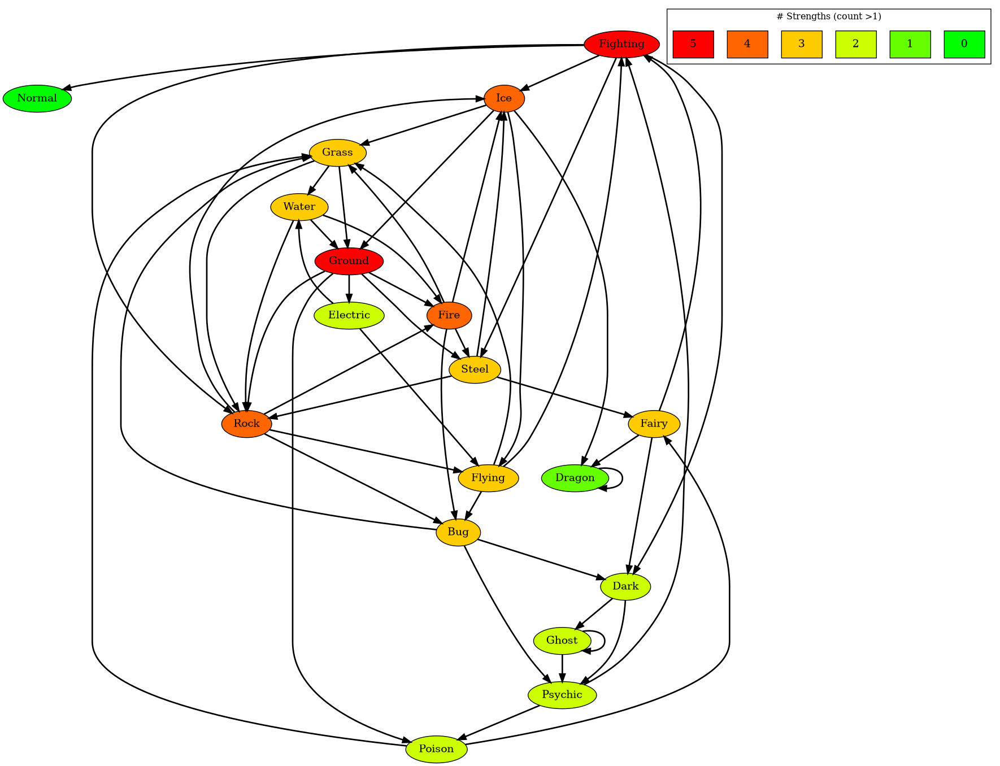

In [9]:
dot = Digraph(engine='dot')

# Set graph attributes to scale to fit
# dot.attr(size="3,3")       # width,height in inches
# dot.attr(ratio="fill")     # scale graph to fill the size
# dot.attr(dpi="200")        # optional, increase resolution for clarity

# Count how many entries > 1 per column
counts = (df > 1).sum(axis=0)
max_count = counts.max()

# Interpolate green -> yellow -> red
def color_for_value(val, vmax):
    if vmax == 0:
        return "#cccccc"  # gray if everything is zero
    ratio = val / vmax
    if ratio <= 0.5:
        # Green to Yellow: increase red from 0 to 255, keep green = 255
        r = int(510 * ratio)
        g = 255
        b = 0
    else:
        # Yellow to Red: keep red = 255, decrease green from 255 to 0
        r = 255
        g = int(255 * (1 - 2*(ratio-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

# Build a color map for all integers 0..max_count
palette = {i: color_for_value(i, max_count) for i in range(max_count+1)}
node_colors = {node: palette[counts[node]] for node in counts.index}

# Add nodes with fill color
for n in df.index:
    dot.node(n, style='filled', fillcolor=node_colors[n])

# Add edges where entry > 1, thickness scaled by value (no labels)
for i in df.index:
    for j in df.columns:
        if df.loc[i, j] > 1:
            weight = df.loc[i, j]
            dot.edge(j, i, penwidth=str(weight))

# Add a legend showing colors for each integer
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='# Strengths (count >1)', fontsize='12')
    for val, color in palette.items():
        legend.node(f"L{val}", str(val), style='filled', fillcolor=color, shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# number of give weak x0.5 or NO 0 damage to something

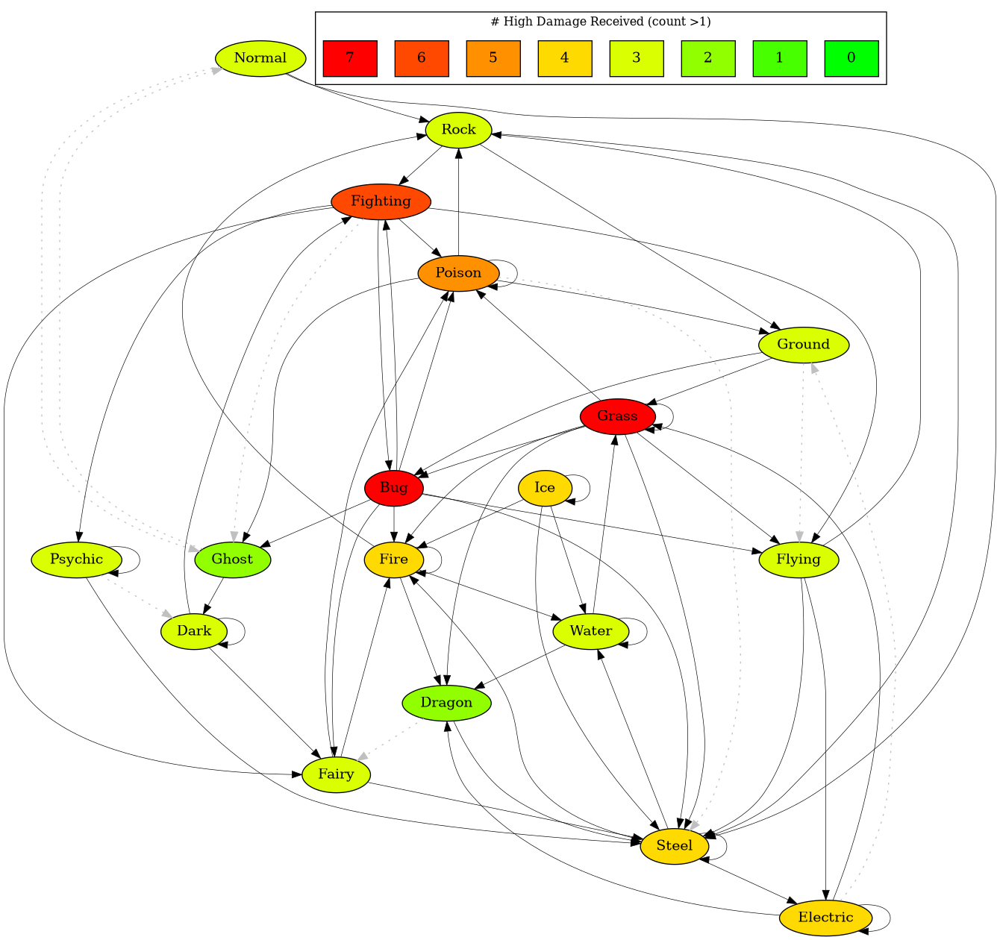

In [10]:
dot = Digraph(engine='dot')

# Count how many entries > 1 per COL
counts = (df < 1).sum(axis=0)
max_count = counts.max()

# Interpolate green -> yellow -> red
def color_for_value(val, vmax):
    if vmax == 0:
        return "#cccccc"  # gray if everything is zero
    ratio = val / vmax
    if ratio <= 0.5:
        # Green to Yellow: increase red from 0 to 255, keep green = 255
        r = int(510 * ratio)
        g = 255
        b = 0
    else:
        # Yellow to Red: keep red = 255, decrease green from 255 to 0
        r = 255
        g = int(255 * (1 - 2*(ratio-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

# Build a color map for all integers 0..max_count
palette = {i: color_for_value(i, max_count) for i in range(max_count+1)}
node_colors = {node: palette[counts[node]] for node in counts.index}

# Add nodes with fill color
for n in df.index:
    dot.node(n, style='filled', fillcolor=node_colors[n])

# Add edges where entry > 1, thickness scaled by value (no labels)
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        # print(weight)
        # print(weight==0.5)
        # print(weight<1)
        if weight==0.5 :
            # print('here')
            dot.edge(j, i, penwidth=str(weight))
        elif weight == 0:
            # show zero-weight edges as dotted
            dot.edge(j, i, style='dotted', penwidth='1', color='gray')

# Add a legend showing colors for each integer
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='# High Damage Received (count >1)', fontsize='12')
    for val, color in palette.items():
        legend.node(f"L{val}", str(val), style='filled', fillcolor=color, shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# number of receive weak x0.5 or NO 0 damage from something

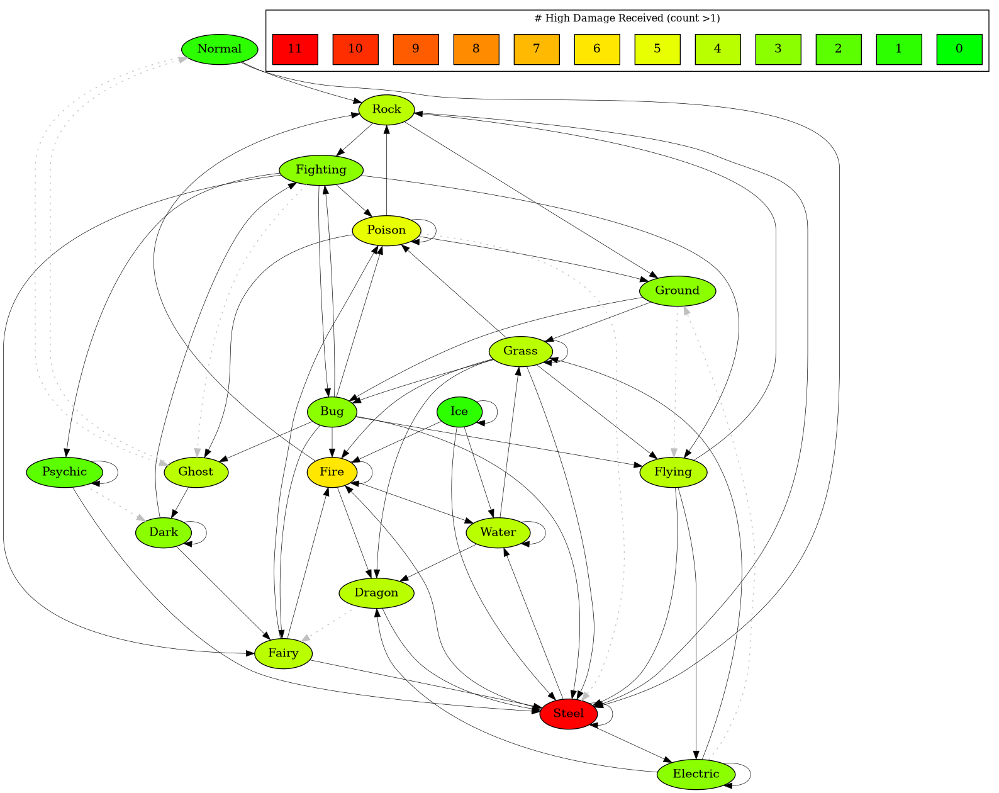

In [11]:
dot = Digraph(engine='dot')

# Count how many entries > 1 per ROW
counts = (df < 1).sum(axis=1)
max_count = counts.max()

# Interpolate green -> yellow -> red
def color_for_value(val, vmax):
    if vmax == 0:
        return "#cccccc"  # gray if everything is zero
    ratio = val / vmax
    if ratio <= 0.5:
        # Green to Yellow: increase red from 0 to 255, keep green = 255
        r = int(510 * ratio)
        g = 255
        b = 0
    else:
        # Yellow to Red: keep red = 255, decrease green from 255 to 0
        r = 255
        g = int(255 * (1 - 2*(ratio-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

# Build a color map for all integers 0..max_count
palette = {i: color_for_value(i, max_count) for i in range(max_count+1)}
node_colors = {node: palette[counts[node]] for node in counts.index}

# Add nodes with fill color
for n in df.index:
    dot.node(n, style='filled', fillcolor=node_colors[n])

# Add edges where entry > 1, thickness scaled by value (no labels)
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        # print(weight)
        # print(weight==0.5)
        # print(weight<1)
        if weight==0.5 :
            # print('here')
            dot.edge(j, i, penwidth=str(weight))
        elif weight == 0:
            # show zero-weight edges as dotted
            dot.edge(j, i, style='dotted', penwidth='1', color='gray')

# Add a legend showing colors for each integer
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='# High Damage Received (count >1)', fontsize='12')
    for val, color in palette.items():
        legend.node(f"L{val}", str(val), style='filled', fillcolor=color, shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# now eigen stuff

In [27]:
eigvals, eigvecs = np.linalg.eig(df.values)
principal_eigenvector = eigvecs[:, np.argmax(eigvals)]
print("Eigenvalues:", eigvals)
print("Principal eigenvector:", principal_eigenvector)

Eigenvalues: [18.71165453+0.j         -0.39722092+2.90064048j -0.39722092-2.90064048j
 -0.88243768+1.6279631j  -0.88243768-1.6279631j   1.15341847+0.j
  0.24831873+1.54409005j  0.24831873-1.54409005j -0.19179171+1.55221168j
 -0.19179171-1.55221168j  0.67756931+0.85229896j  0.67756931-0.85229896j
 -1.28486564+0.j         -0.62888118+0.78587872j -0.62888118-0.78587872j
 -0.40576721+0.1855919j  -0.40576721-0.1855919j   0.08021399+0.j        ]
Principal eigenvector: [0.22760839+0.j 0.22751155+0.j 0.22757068+0.j 0.22169163+0.j
 0.26424057+0.j 0.26812286+0.j 0.24334516+0.j 0.22048132+0.j
 0.24177737+0.j 0.23321727+0.j 0.24993237+0.j 0.24466113+0.j
 0.26394292+0.j 0.21243984+0.j 0.23946037+0.j 0.23816156+0.j
 0.18825991+0.j 0.21559939+0.j]


# eigenvector

Eigenvalues: [18.71165453+0.j         -0.39722092+2.90064048j -0.39722092-2.90064048j
 -0.88243768+1.6279631j  -0.88243768-1.6279631j   1.15341847+0.j
  0.24831873+1.54409005j  0.24831873-1.54409005j -0.19179171+1.55221168j
 -0.19179171-1.55221168j  0.67756931+0.85229896j  0.67756931-0.85229896j
 -1.28486564+0.j         -0.62888118+0.78587872j -0.62888118-0.78587872j
 -0.40576721+0.1855919j  -0.40576721-0.1855919j   0.08021399+0.j        ]


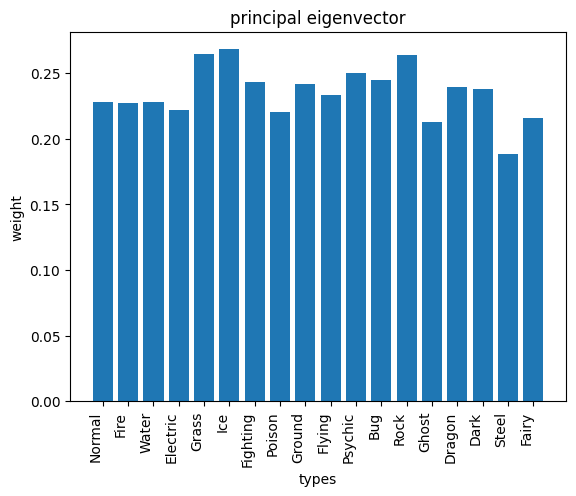

In [25]:
ntypes = len(principal_eigenvector)
x = range(ntypes)
y = np.real(principal_eigenvector)
plt.bar(x,y)
plt.xlabel('types')
plt.ylabel('weight')
plt.title('principal eigenvector')
plt.xticks(ticks=x, labels=ptypes, rotation=90, ha='right')
plt.show()

# eigenvalues

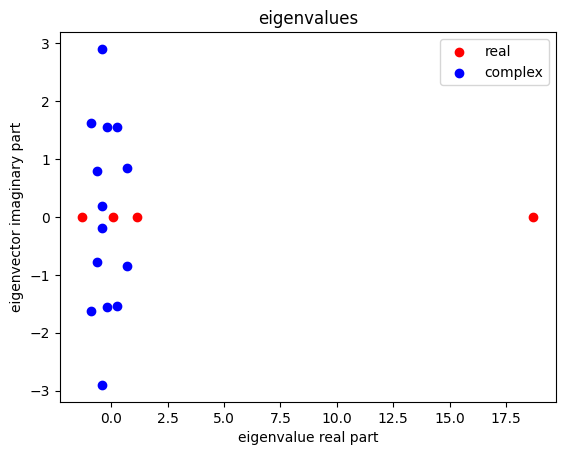

In [26]:
plt.figure()
for e in eigvals:
    c = 'blue'
    l = 'complex'
    r = np.real(e)
    i = np.imag(e)
    if i==0:
        c ='red'
        l ='real'
        # print(r)
    plt.scatter(r, i,color=c,label=l)
    
plt.xlabel('eigenvalue real part')
plt.ylabel('eigenvector imaginary part')

# remove duplicates
handles, labels = plt.gca().get_legend_handles_labels()
unique = dict(zip(labels, handles))  # later duplicates override earlier ones
plt.legend(unique.values(), unique.keys())
# plt.legend()
plt.title('eigenvalues')

plt.show()  
        

# color & scale the nodes by their weight in principal vector

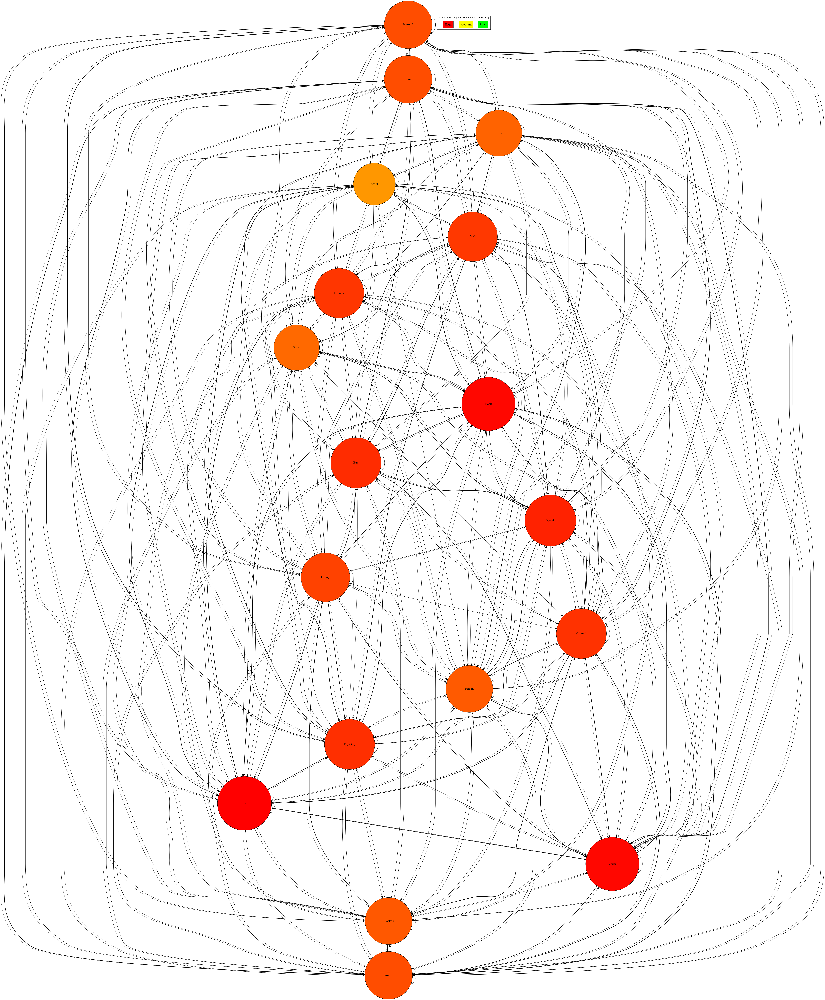

In [28]:
dot = Digraph(engine='dot')

# Compute eigenvector centrality
eigvals, eigvecs = np.linalg.eig(df.values)
principal_idx = np.argmax(eigvals.real)  # largest eigenvalue
centrality = eigvecs[:, principal_idx].real
# normalize to 0..1
centrality = centrality / np.max(centrality)

# Interpolate colors: green → yellow → red
def color_for_centrality(c):
    # c is in [0,1]
    if c <= 0.5:
        r = int(510 * c)
        g = 255
        b = 0
    else:
        r = 255
        g = int(255 * (1 - 2*(c-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

node_colors = {node: color_for_centrality(centrality[i]) for i, node in enumerate(df.index)}

# Add nodes with fill color and size scaled by centrality
min_size = 1  # minimum node width in inches
max_size = 4.0  # maximum node width in inches

for i, n in enumerate(df.index):
    size = min_size + (max_size - min_size) * centrality[i]  # scale linearly
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')
    
# Add edges where entry >1, thickness scaled by value
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        # if weight > 1: 
        dot.edge(j, i, penwidth=str(weight))

# Optional: add a legend for centrality (example: 0%, 50%, 100%)
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Scale graph to fit nicely
# dot.attr(size="8,8", ratio="fill", dpi="200")

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# PRINCIPAL EIGENVECTOR FOR STRENGTH x2 DAMAGE RECEIVED

In [29]:
dot = Digraph(engine='dot')

df2 = df[df>1]
df2 = df2.fillna(0)

# Compute eigenvector centrality
eigvals, eigvecs = np.linalg.eig(df2.values)
principal_idx = np.argmax(eigvals.real)  # largest eigenvalue
centrality = eigvecs[:, principal_idx].real
# normalize to 0..1
centrality = centrality / np.max(centrality)

# Interpolate colors: green → yellow → red
def color_for_centrality(c):
    # c is in [0,1]
    if c <= 0.5:
        r = int(510 * c)
        g = 255
        b = 0
    else:
        r = 255
        g = int(255 * (1 - 2*(c-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

node_colors = {node: color_for_centrality(centrality[i]) for i, node in enumerate(df.index)}

# Add nodes with fill color and size scaled by centrality
min_size = 1  # minimum node width in inches
max_size = 4.0  # maximum node width in inches

for i, n in enumerate(df.index):
    size = min_size + (max_size - min_size) * centrality[i]  # scale linearly
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')
    
# Add edges where entry >1, thickness scaled by value
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        if weight > 1: 
            dot.edge(j, i, penwidth=str(weight))

# Optional: add a legend for centrality (example: 0%, 50%, 100%)
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Scale graph to fit nicely
# dot.attr(size="8,8", ratio="fill", dpi="200")

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# PRINCIPAL EIGENVECTOR FOR WEAK x0.5 DAMAGE RECEIVED

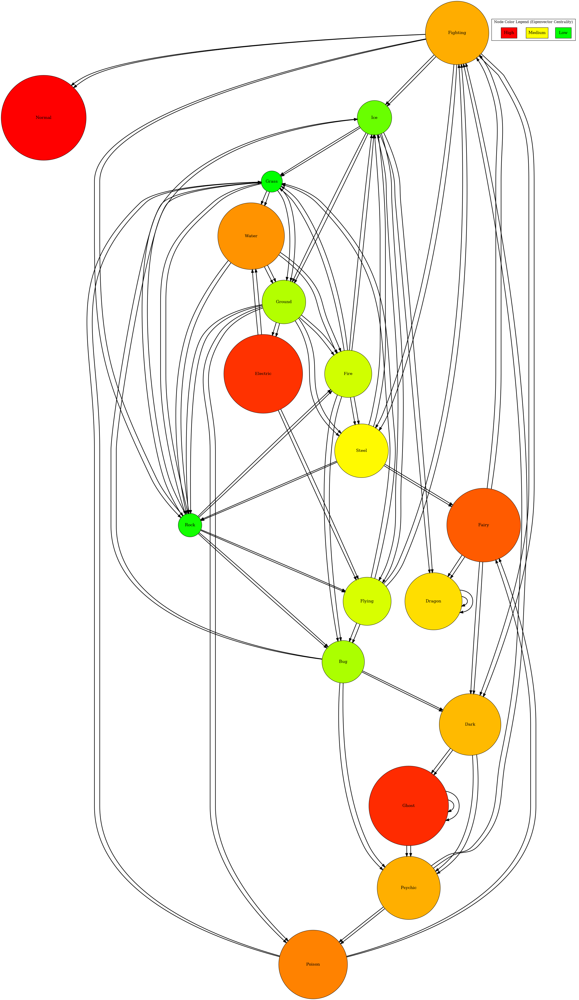

In [30]:
# --- prepare df2 (you already do this) ---
df2 = df[df > 1]
df2 = df2.fillna(0)

# Compute eigenvector centrality (principal eigenvector)
eigvals, eigvecs = np.linalg.eig(df2.values)
principal_idx = np.argmax(eigvals.real)
centrality_raw = eigvecs[:, principal_idx].real

# Defensive clean-up (remove NaN/inf)
centrality_raw = np.nan_to_num(centrality_raw, nan=0.0, posinf=0.0, neginf=0.0)

# Rescale to [0,1] in a numerically stable way (handles negative values)
minv = np.min(centrality_raw)
maxv = np.max(centrality_raw)

if np.isclose(maxv, minv):
    # all values equal -> make them zero (or set small constant if you prefer visible nodes)
    centrality = np.zeros_like(centrality_raw, dtype=float)
else:
    centrality = (centrality_raw - minv) / (maxv - minv)
    # ensure numeric stability
    centrality = np.clip(centrality, 0.0, 1.0)

# Optionally ensure a minimum non-zero for visibility (uncomment to use)
# epsilon = 0.02
# centrality = np.clip(centrality, epsilon, 1.0)

# Robust color function (clips / safe ints)
def color_for_centrality(c):
    # ensure scalar float, clip to [0,1]
    try:
        c = float(c)
    except Exception:
        c = 0.0
    c = 0.0 if np.isnan(c) else c
    c = min(max(c, 0.0), 1.0)

    if c <= 0.5:
        # ramp r: 0 -> 255 as c: 0 -> 0.5  (so use 510*c)
        r = int(round(510 * c))
        g = 255
        b = 0
    else:
        r = 255
        # ramp g: 255 -> 0 as c: 0.5 -> 1.0
        g = int(round(255 * (1 - 2 * (c - 0.5))))
        b = 0

    # Clip to valid 0..255 ints
    r = int(min(max(r, 0), 255))
    g = int(min(max(g, 0), 255))
    b = int(min(max(b, 0), 255))
    return f"#{r:02x}{g:02x}{b:02x}"

# Build node_colors mapping — ensure lengths match
if len(centrality) != len(df.index):
    raise RuntimeError("centrality length mismatch with df.index — check the order and indexing.")

node_colors = {node: color_for_centrality(centrality[i]) for i, node in enumerate(df.index)}

# Add nodes with fill color and size scaled by centrality
min_size = 1.0  # minimum node width in inches
max_size = 4.0  # maximum node width in inches

for i, n in enumerate(df.index):
    size = min_size + (max_size - min_size) * centrality[i]
    # Graphviz expects strings for width/height; fixedsize='true' will use these as exact values
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')

# Add edges where entry > 1, thickness scaled by value
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        if weight > 1:
            # make penwidth at least 0.5 for visibility if needed
            penwidth = float(weight)
            if penwidth <= 0:
                penwidth = 0.5
            dot.edge(j, i, penwidth=str(penwidth))

# Optional: add a legend for centrality (example: 0%, 50%, 100%)
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

# 0 damage eigenvector

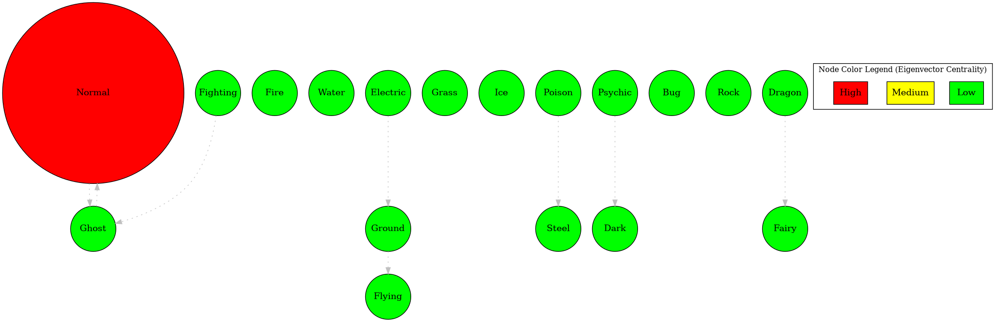

In [31]:
dot = Digraph(engine='dot')

df2 = df[df==0]
df2 = df2.fillna(0)

# Compute eigenvector centrality
eigvals, eigvecs = np.linalg.eig(df2.values)
principal_idx = np.argmax(eigvals.real)  # largest eigenvalue
centrality = eigvecs[:, principal_idx].real
# normalize to 0..1
centrality = centrality / np.max(centrality)

# Interpolate colors: green → yellow → red
def color_for_centrality(c):
    # c is in [0,1]
    if c <= 0.5:
        r = int(510 * c)
        g = 255
        b = 0
    else:
        r = 255
        g = int(255 * (1 - 2*(c-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

node_colors = {node: color_for_centrality(centrality[i]) for i, node in enumerate(df.index)}

# Add nodes with fill color and size scaled by centrality
min_size = 1  # minimum node width in inches
max_size = 4.0  # maximum node width in inches

for i, n in enumerate(df.index):
    size = min_size + (max_size - min_size) * centrality[i]  # scale linearly
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')
    
# Add edges where entry >1, thickness scaled by value
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        if weight == 0:
            # show zero-weight edges as dotted
            dot.edge(j, i, style='dotted', penwidth='1', color='gray')

# Optional: add a legend for centrality (example: 0%, 50%, 100%)
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Scale graph to fit nicely
# dot.attr(size="8,8", ratio="fill", dpi="200")

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

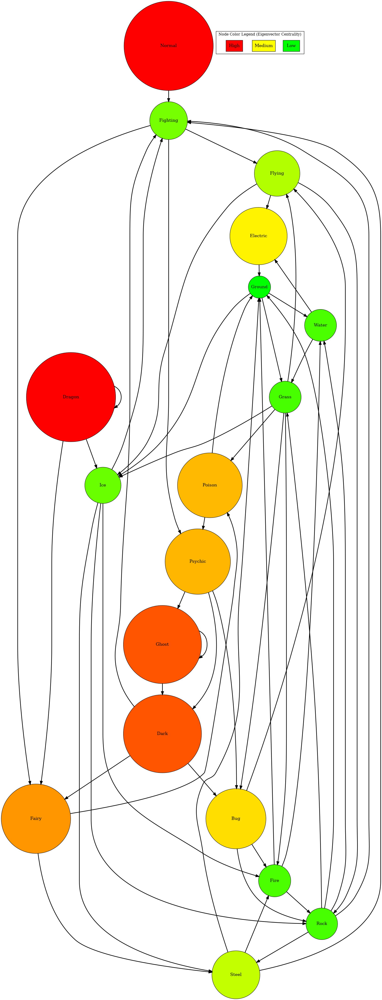

In [32]:
dot = Digraph(engine='dot')

# Prepare df2 (you already did this)
df2 = df[df > 1].fillna(0).T  # note: transposed on purpose in your code

# Compute eigenvector centrality (principal eigenvector)
eigvals, eigvecs = np.linalg.eig(df2.values)
principal_idx = np.argmax(eigvals.real)
centrality_raw = eigvecs[:, principal_idx].real

# Defensive cleanup: remove NaN/inf -> 0
centrality_raw = np.nan_to_num(centrality_raw, nan=0.0, posinf=0.0, neginf=0.0)

# Normalize robustly to [0,1]
minv = np.min(centrality_raw)
maxv = np.max(centrality_raw)
if np.isclose(maxv, minv):
    centrality = np.zeros_like(centrality_raw, dtype=float)
else:
    centrality = (centrality_raw - minv) / (maxv - minv)
centrality = np.clip(centrality, 0.0, 1.0)

# centrality corresponds to df2.index (after transpose).
# That means its labels are df2.index (which equals df.columns before transpose).
# Try to create a Series with those labels and then reindex to df.index for node mapping.
try:
    import pandas as pd
    centrality_series = pd.Series(centrality, index=df2.index)
    # Reindex to df.index — if labels match they'll align, otherwise missing -> 0
    centrality_aligned = centrality_series.reindex(df.index).fillna(0.0).to_numpy()
except Exception:
    # If pandas not available or something fails, fall back to best-effort mapping:
    if len(centrality) == len(df.index):
        centrality_aligned = centrality
    elif len(centrality) == len(df.columns):
        # assume centrality aligns with df.columns — attempt to map by order to df.index if sizes equal
        centrality_aligned = np.zeros(len(df.index))
        min_len = min(len(centrality), len(df.index))
        centrality_aligned[:min_len] = centrality[:min_len]
    else:
        # last-resort: all zeros
        centrality_aligned = np.zeros(len(df.index))

# Robust color function
def color_for_centrality(c):
    try:
        c = float(c)
    except Exception:
        c = 0.0
    if np.isnan(c):
        c = 0.0
    c = float(np.clip(c, 0.0, 1.0))

    if c <= 0.5:
        r = int(round(510 * c))   # 0..255 as c:0..0.5
        g = 255
    else:
        r = 255
        g = int(round(255 * (1 - 2 * (c - 0.5))))  # 255..0 as c:0.5..1
    b = 0
    # Clip again to be extra-safe
    r = int(min(max(r, 0), 255))
    g = int(min(max(g, 0), 255))
    return f"#{r:02x}{g:02x}{b:02x}"

# Build node_colors for nodes in df.index (use aligned centrality)
node_colors = {node: color_for_centrality(centrality_aligned[i]) for i, node in enumerate(df.index)}

# Node sizes scaled by aligned centrality
min_size = 1.0
max_size = 4.0

for i, n in enumerate(df.index):
    cval = centrality_aligned[i]
    size = min_size + (max_size - min_size) * float(cval)
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')

# Add edges where entry > 1 (same orientation as your final edge call)
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        if weight > 1:
            penwidth = float(weight) if np.isfinite(weight) and weight > 0 else 0.5
            dot.edge(i, j, penwidth=str(penwidth))

# Legend
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline

In [33]:
dot = Digraph(engine='dot')

df2 = df[df<1]
df2 = df2.fillna(0)
df2 = df2.T

# Compute eigenvector centrality
eigvals, eigvecs = np.linalg.eig(df2.values)
principal_idx = np.argmax(eigvals.real)  # largest eigenvalue
centrality = eigvecs[:, principal_idx].real
# normalize to 0..1
centrality = centrality / np.max(centrality)

# Interpolate colors: green → yellow → red
def color_for_centrality(c):
    # c is in [0,1]
    if c <= 0.5:
        r = int(510 * c)
        g = 255
        b = 0
    else:
        r = 255
        g = int(255 * (1 - 2*(c-0.5)))
        b = 0
    return f"#{r:02x}{g:02x}{b:02x}"

node_colors = {node: color_for_centrality(centrality[i]) for i, node in enumerate(df.index)}

# Add nodes with fill color and size scaled by centrality
min_size = 1  # minimum node width in inches
max_size = 4.0  # maximum node width in inches

for i, n in enumerate(df.index):
    size = min_size + (max_size - min_size) * centrality[i]  # scale linearly
    dot.node(n, style='filled', fillcolor=node_colors[n], width=str(size), height=str(size), fixedsize='true')
    
# Add edges where entry >1, thickness scaled by value
for i in df.index:
    for j in df.columns:
        weight = df.loc[i, j]
        if weight < 1: 
            dot.edge(i, j, penwidth=str(weight))
        elif weight == 0:
            # show zero-weight edges as dotted
            dot.edge(i, j, style='dotted', penwidth='1', color='gray')

# Optional: add a legend for centrality (example: 0%, 50%, 100%)
with dot.subgraph(name='cluster_legend') as legend:
    legend.attr(label='Node Color Legend (Eigenvector Centrality)', fontsize='12')
    for c_frac, label in zip([0, 0.5, 1], ["Low", "Medium", "High"]):
        legend.node(f"L{label}", label, style='filled', fillcolor=color_for_centrality(c_frac), shape='box')
    legend.attr(color='black')

# Scale graph to fit nicely
# dot.attr(size="8,8", ratio="fill", dpi="200")

# Render as PNG in memory and display in notebook
png_bytes = dot.pipe(format='png')  # returns PNG bytes
Image(png_bytes)                     # display inline